In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

from __future__ import division
from __future__ import print_function
from __future__ import absolute_import
from __future__ import unicode_literals  

import numpy as np
import pandas as pd
from sklearn import linear_model, preprocessing, cluster
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.linalg as slin
import scipy.sparse.linalg as sparselin
import scipy.sparse as sparse
import IPython

import tensorflow as tf

from inceptionModel import BinaryInceptionModel
from logisticRegressionWithLBFGS import LogisticRegressionWithLBFGS
from binaryLogisticRegressionWithLBFGS import BinaryLogisticRegressionWithLBFGS

from load_animals import load_animals

import experiments
from image_utils import plot_flat_bwimage, plot_flat_bwgrad, plot_flat_colorimage, plot_flat_colorgrad
 
from dataset import DataSet
from tensorflow.contrib.learn.python.learn.datasets import base

sns.set(color_codes=True)

Using TensorFlow backend.


In [2]:
def reverse_preprocess(x):
    x /= 2.
    x += 0.5
    return x

# Setup

In [4]:
num_train_ex_per_class = 900
num_test_ex_per_class = 300

model_name = 'animals_%s_%s' % (num_train_ex_per_class, num_test_ex_per_class)
# image_data_sets = load_animals(num_train_ex_per_class=num_train_ex_per_class, num_test_ex_per_class=num_test_ex_per_class)

In [10]:
train_f = np.load('/srv/scratch/pangwei/influence_data/%s_inception_features_train.npz' % model_name)
train = DataSet(train_f['inception_features_val'], train_f['labels'])
test_f = np.load('/srv/scratch/pangwei/influence_data/%s_inception_features_test.npz' % model_name)
test = DataSet(test_f['inception_features_val'], test_f['labels'])
validation = None

data_sets = base.Datasets(train=train, validation=validation, test=test)

input_dim = 2048
weight_decay = 0.01
batch_size = 900
initial_learning_rate = 0.001 
keep_probs = None
decay_epochs = [1000, 10000]
max_lbfgs_iter = 1000
num_classes = 10

tf.reset_default_graph()

model = LogisticRegressionWithLBFGS(
    input_dim=input_dim,
    weight_decay=weight_decay,
    max_lbfgs_iter=max_lbfgs_iter,
    num_classes=num_classes, 
    batch_size=batch_size,
    data_sets=data_sets,
    initial_learning_rate=initial_learning_rate,
    keep_probs=keep_probs,
    decay_epochs=decay_epochs,
    mini_batch=False,
    train_dir='data',
    log_dir='log',
    model_name='animals_inception_onlytop_poisoned')

model.train()
weights = model.sess.run(model.weights)
np.save('data/inception_weights_%s' % model_name, weights)

Y_pred = model.sess.run(model.preds, feed_dict=model.all_test_feed_dict)
Y_test = model.data_sets.test.labels

Total number of parameters: 20480
Using normal model
LBFGS training took [72] iter.
After training with LBFGS: 
Train loss (w reg) on all data: 0.117541
Test loss (w/o reg) on all data: 0.202384
Train acc on all data:  0.991
Test acc on all data:   0.943666666667
Norm of the mean of gradients: 1.41374e-05
Norm of the params: 3.29989


# Look for good test_idx

In [9]:
model.data_sets.test.labels 

array([ 5.,  2.,  2., ...,  8.,  6.,  6.])

In [10]:
 image_data_sets.test.labels

array([ 0.,  5.,  8., ...,  3.,  6.,  5.])

In [12]:
assert np.all(model.data_sets.test.labels == image_data_sets.test.labels)
assert np.all(model.data_sets.train.labels == image_data_sets.train.labels)

/users/pangwei/miniconda3/envs/py27/lib/python2.7/site-packages/ipykernel/__main__.py:5: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


201 0.988933


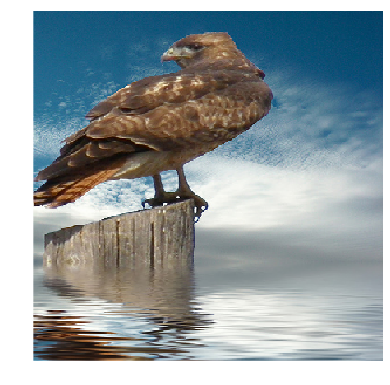

203 0.618373


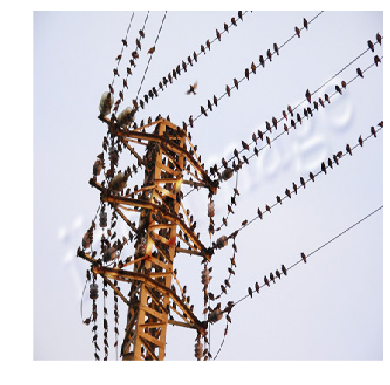

210 0.594774


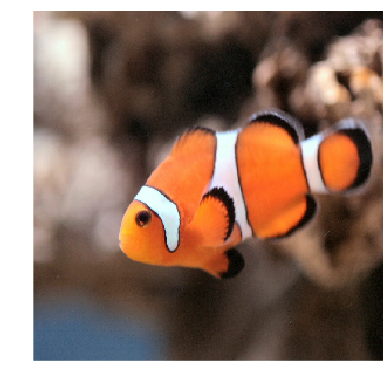

213 0.857126


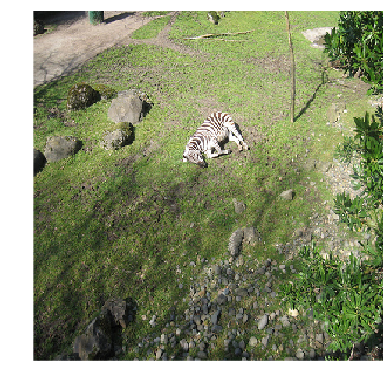

216 0.807488


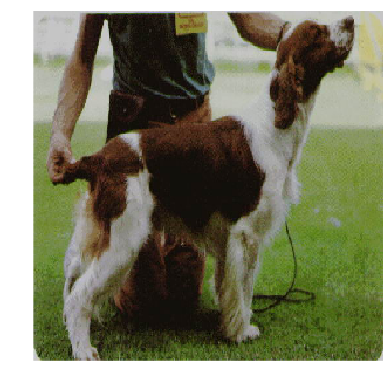

224 0.806654


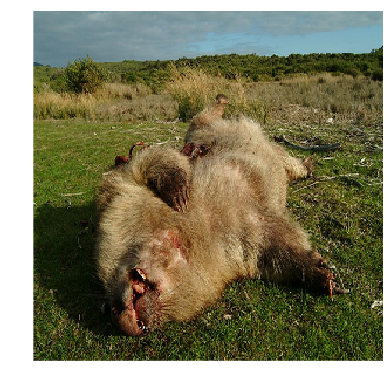

225 0.966291


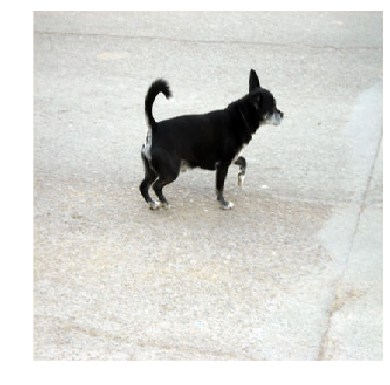

226 0.981206


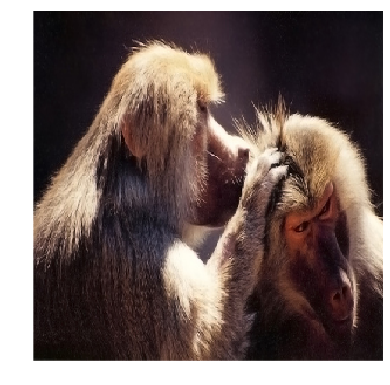

232 0.94569


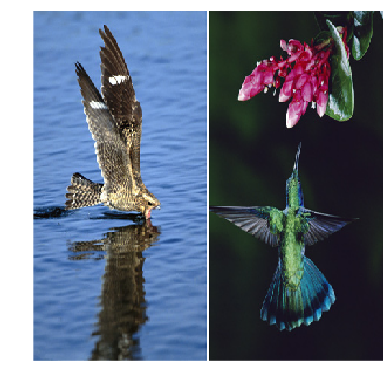

233 0.748557


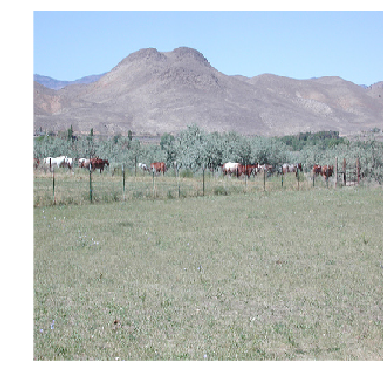

235 0.987567


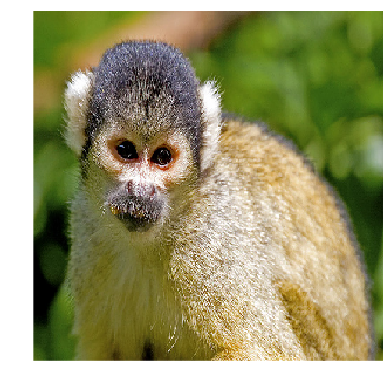

237 0.24144


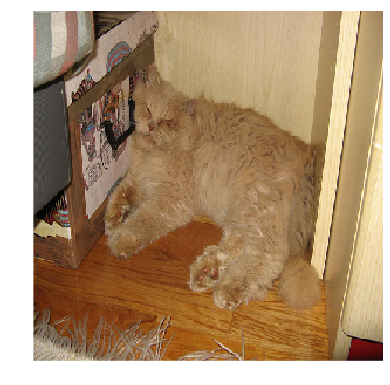

240 0.836723


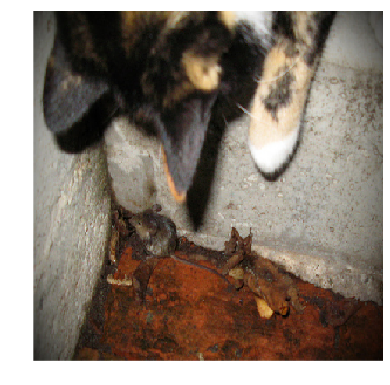

243 0.98813


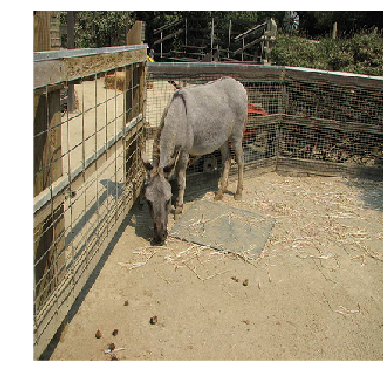

244 0.0263649


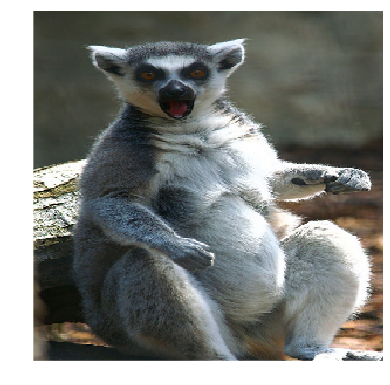

254 0.98114


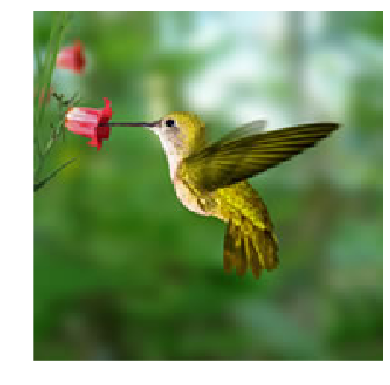

256 0.82994


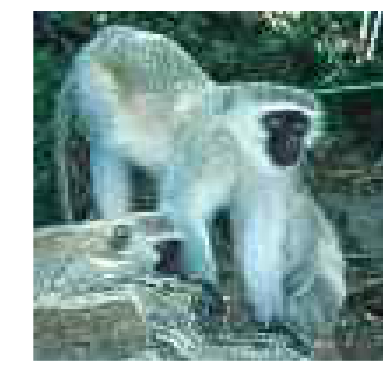

258 0.987387


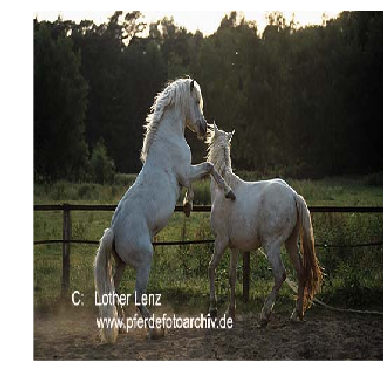

259 0.979866


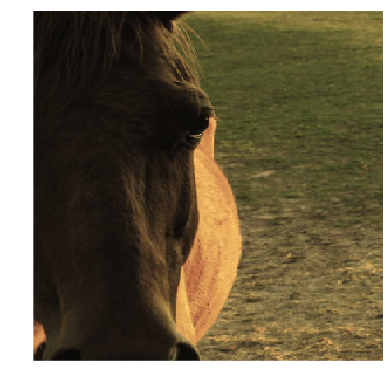

260 0.941088


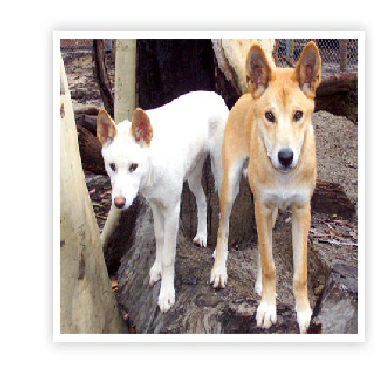

262 0.968038


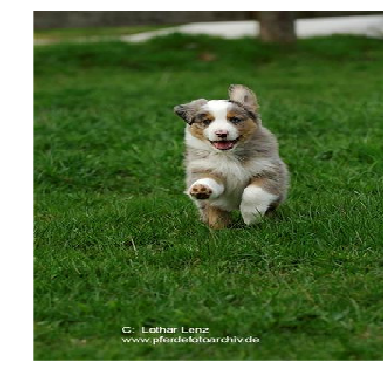

264 0.82492


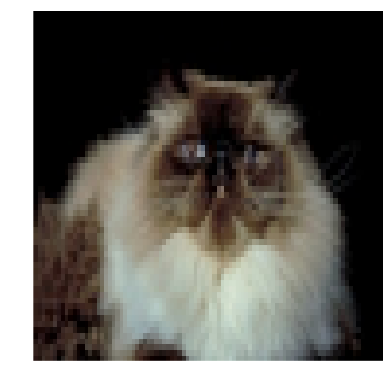

268 0.98047


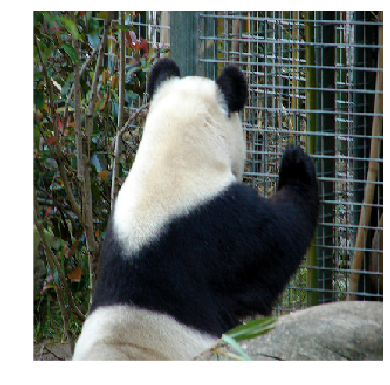

272 0.907655


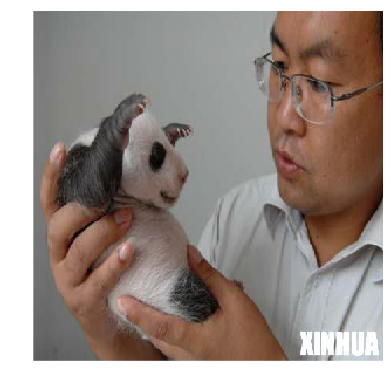

273 0.984172


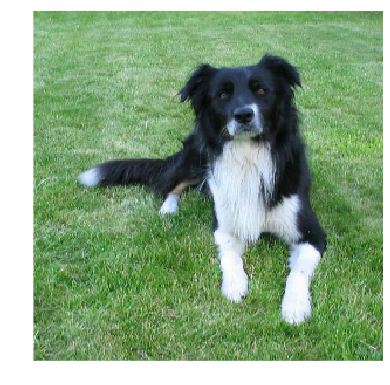

274 0.902911


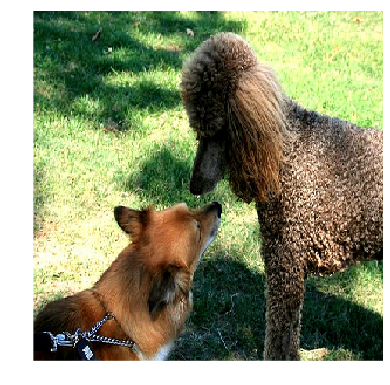

275 0.950758


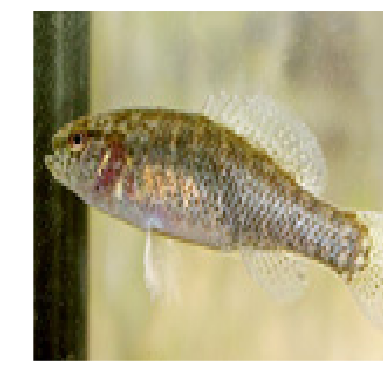

276 0.977823


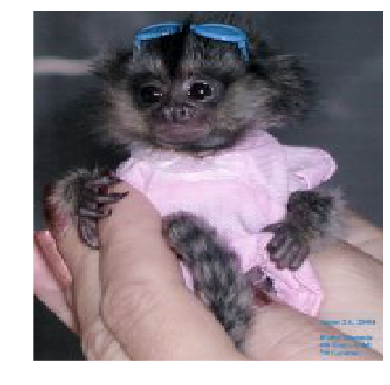

279 0.96003


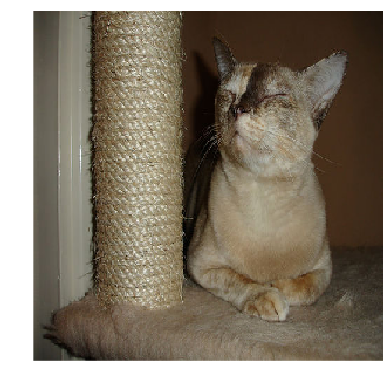

281 0.962839


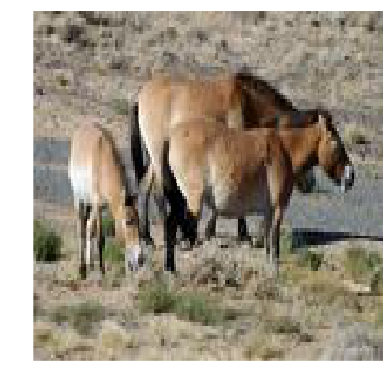

285 0.98852


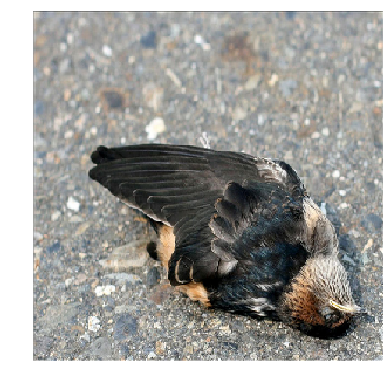

286 0.944731


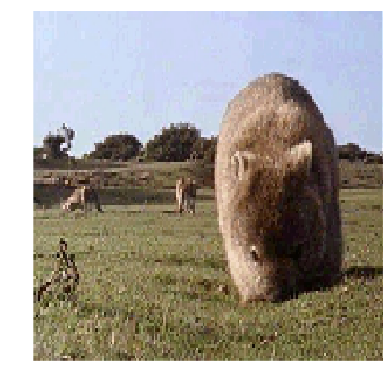

292 0.98614


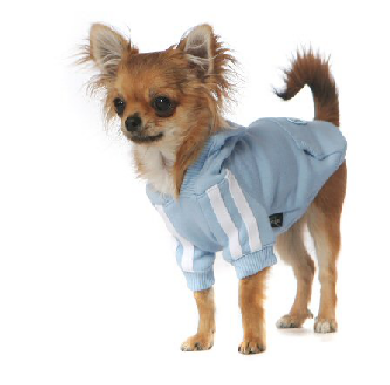

296 0.126662


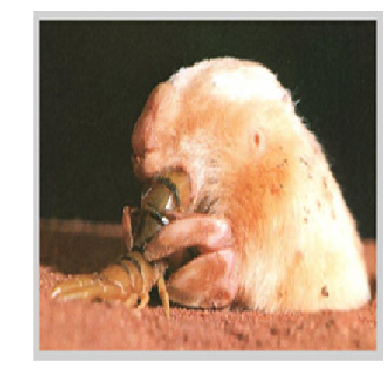

297 0.947959


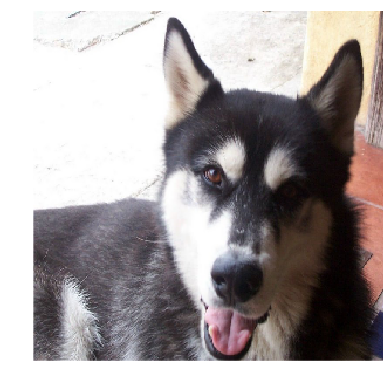

298 0.975673


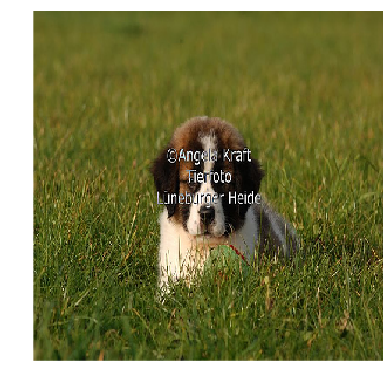

301 0.0576257


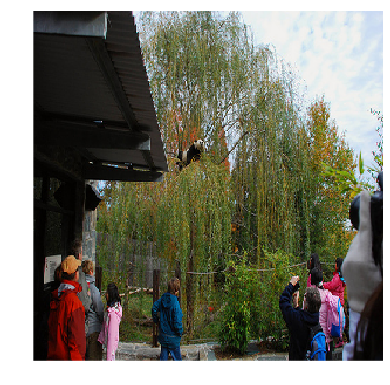

303 0.864869


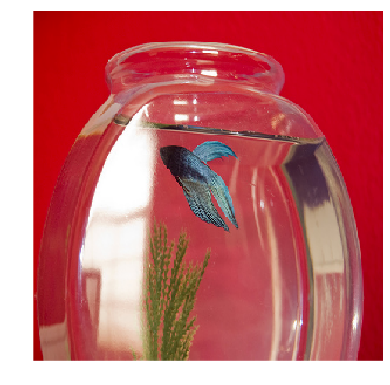

304 0.980167


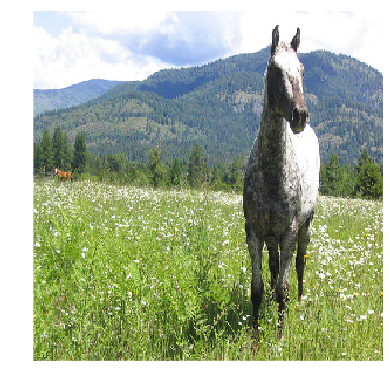

308 0.976438


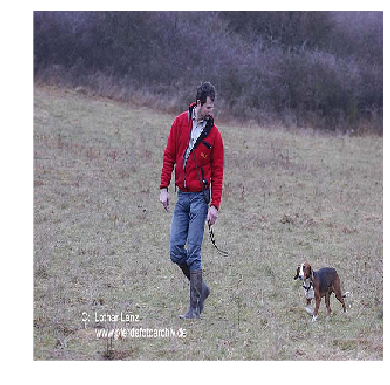

311 0.751896


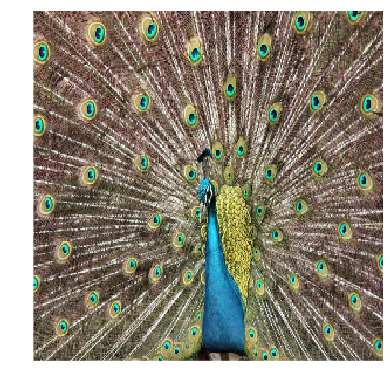

312 0.983653


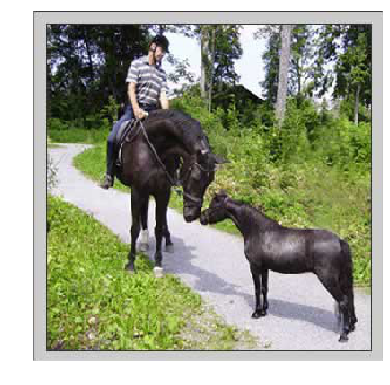

314 0.959349


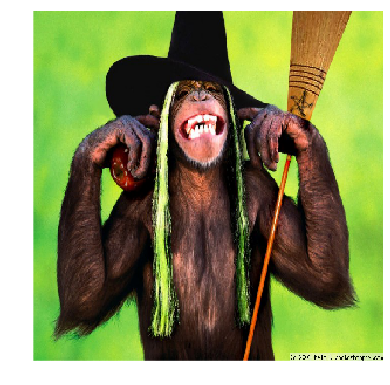

315 0.427759


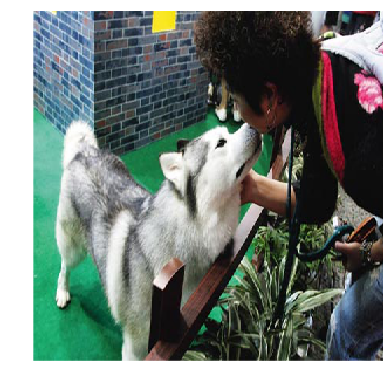

324 0.813789


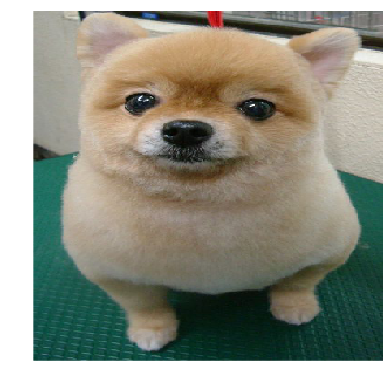

331 0.966236


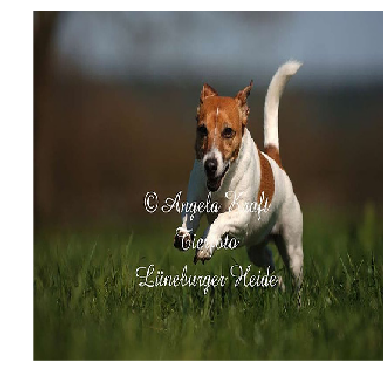

332 0.947394


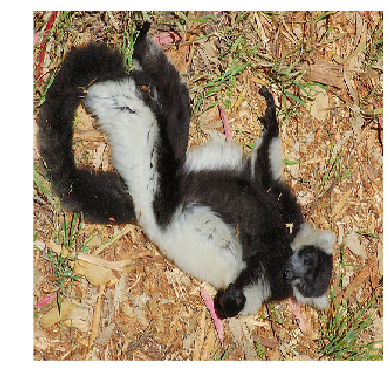

336 0.989227


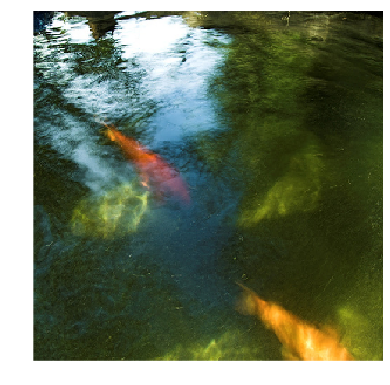

339 0.989627


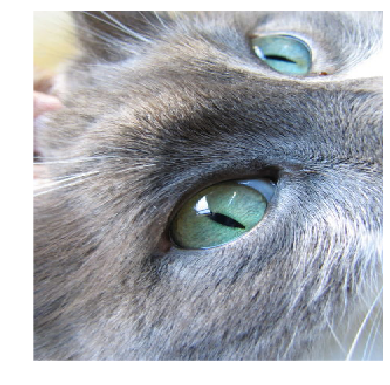

340 0.923174


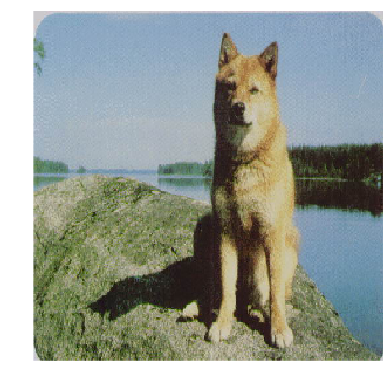

343 0.980296


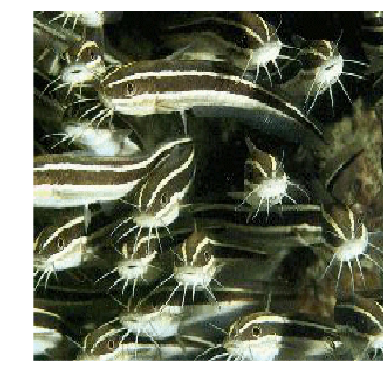

344 0.911273


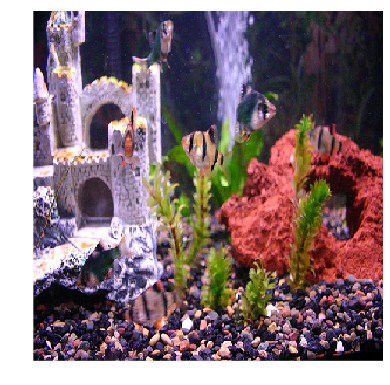

346 0.853698


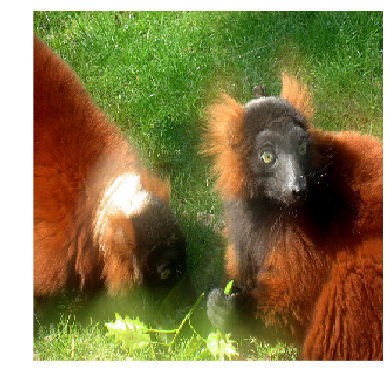

349 0.134631


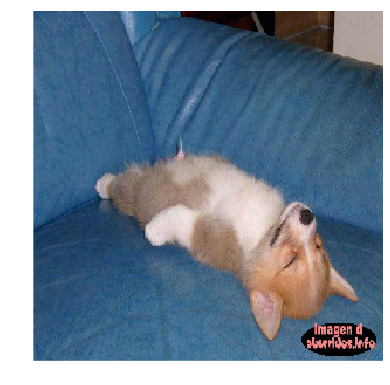

350 0.986109


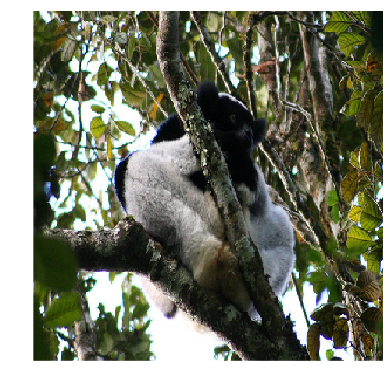

352 0.40651


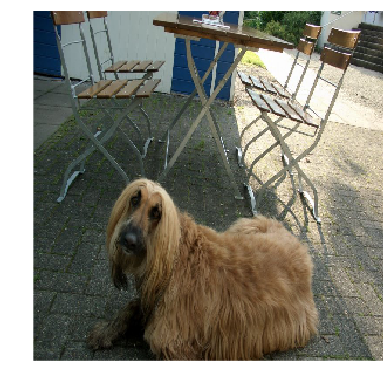

354 0.971893


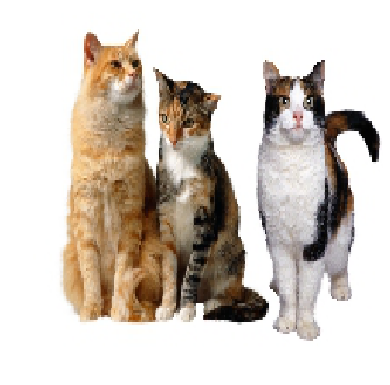

357 0.985063


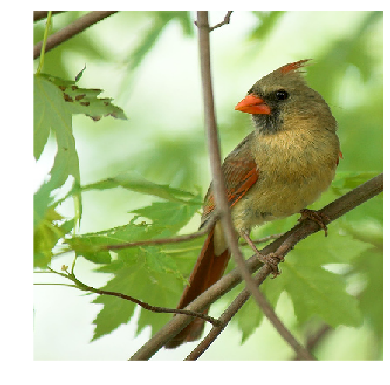

361 0.984606


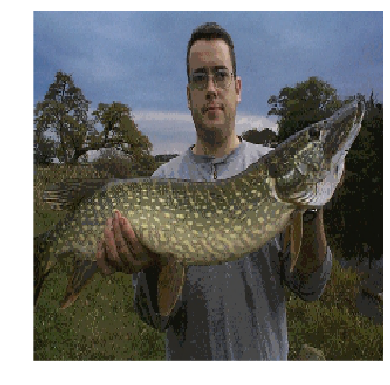

363 0.967646


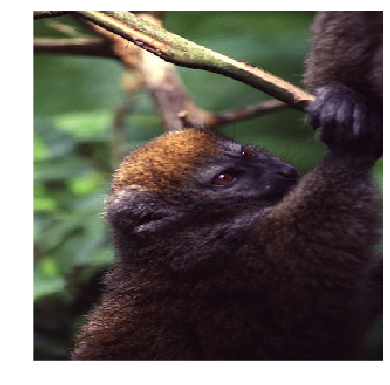

367 0.0131675


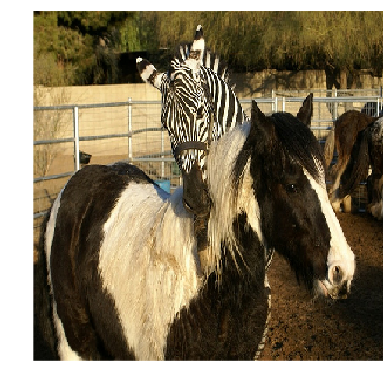

368 0.584983


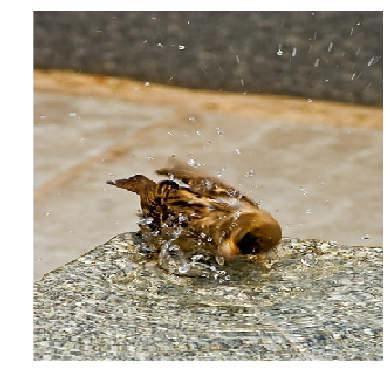

369 0.838594


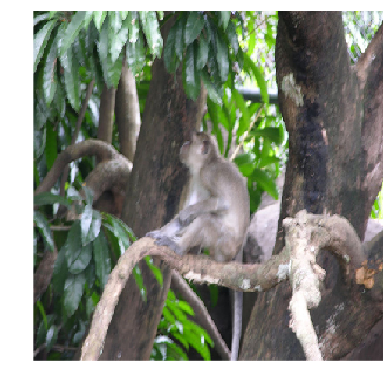

376 0.0172747


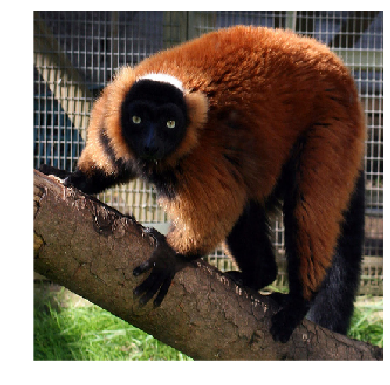

381 0.840271


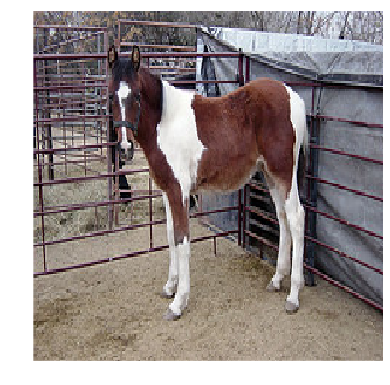

382 0.980806


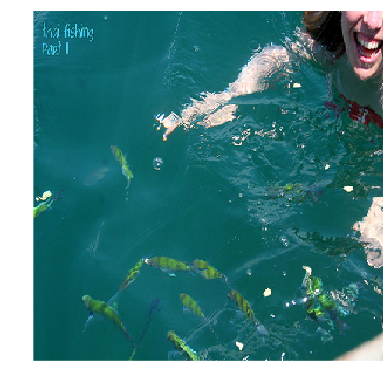

383 0.94746


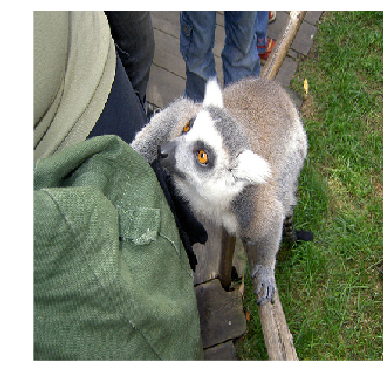

384 0.700287


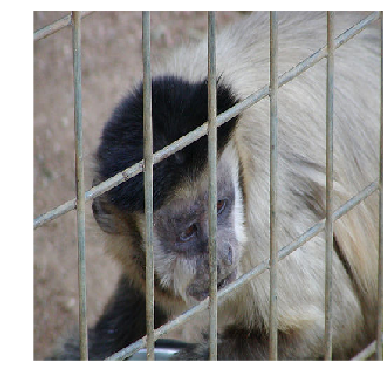

385 0.465184


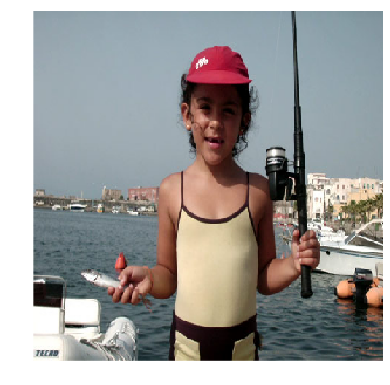

386 0.79191


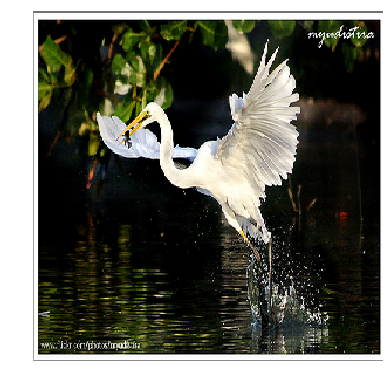

387 0.64753


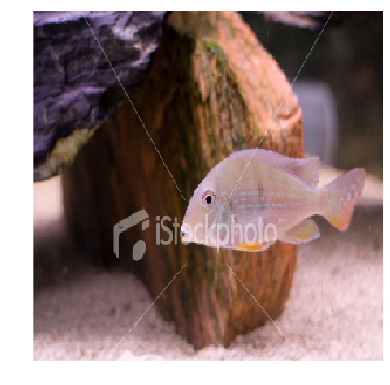

391 0.357741


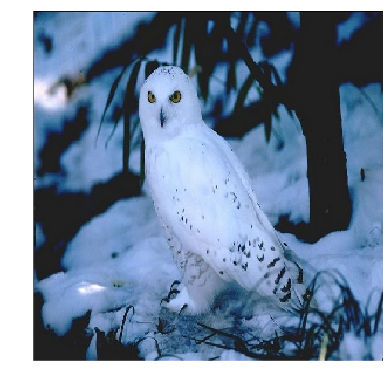

392 0.92911


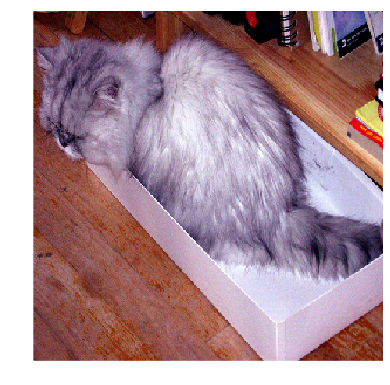

394 0.962392


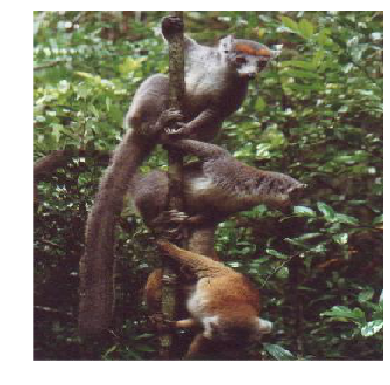

395 0.969534


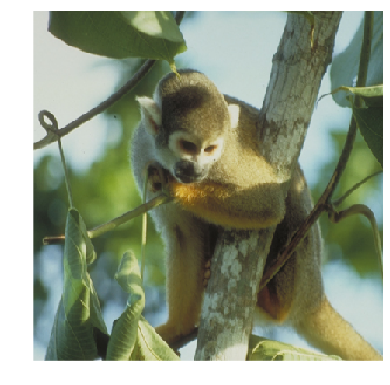

396 0.662224


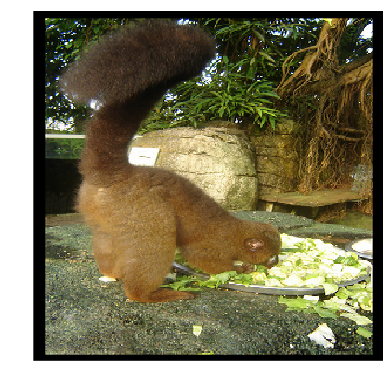

397 0.962612


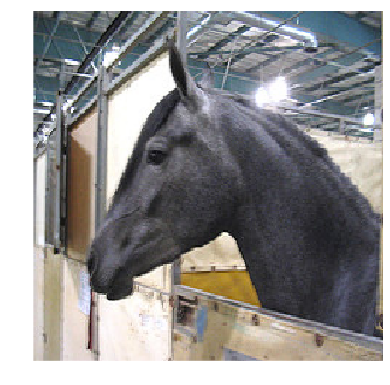

In [19]:
for test_idx in range(200,400):    
    if np.max(Y_pred[test_idx, :]) > 0.99: continue
#     if Y_test[test_idx] != 0: continue
#     test_idx = 0
    print(test_idx, Y_pred[test_idx,  Y_test[test_idx]])
    plt.imshow((np.reshape(image_data_sets.test.x[test_idx, :], [299, 299, 3]) + 1) / 2, interpolation='none')  
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [25]:
test_indices = [11, 41, 54, 66, 85, 88, 100, 125, 173]

/users/pangwei/miniconda3/envs/py27/lib/python2.7/site-packages/ipykernel/__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


11 0.961979


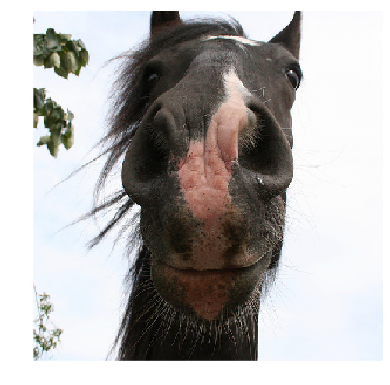

41 0.975805


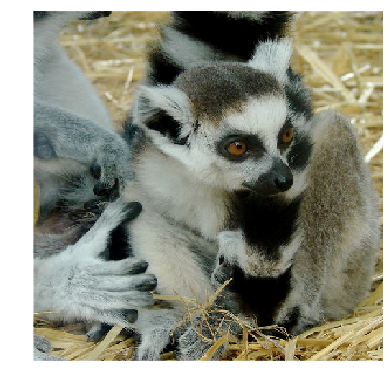

54 0.985501


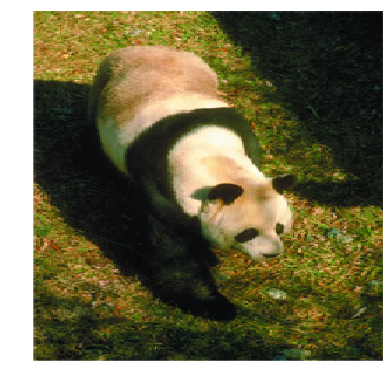

66 0.986604


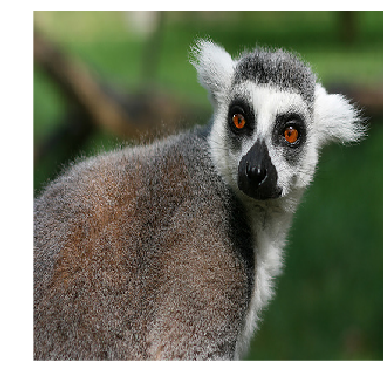

85 0.984716


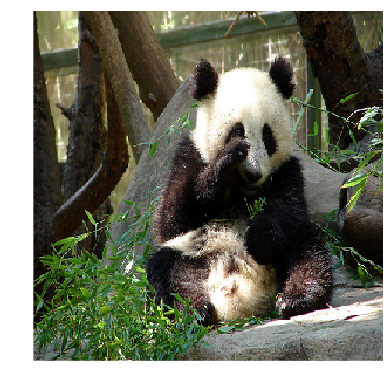

88 0.986016


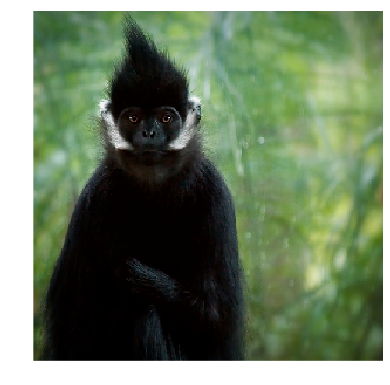

100 0.926866


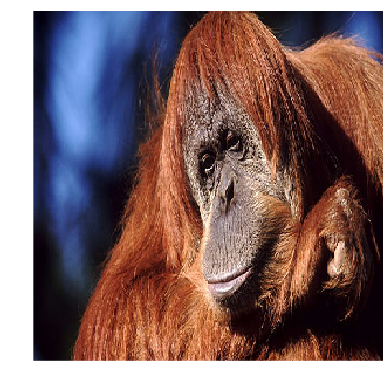

125 0.976268


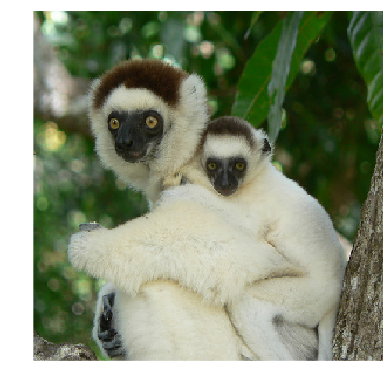

173 0.951763


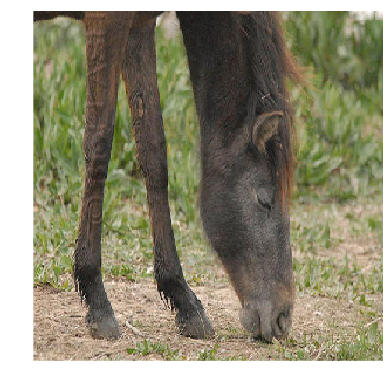

In [26]:
for test_idx in test_indices:
    print(test_idx, Y_pred[test_idx,  Y_test[test_idx]])
    plt.imshow((np.reshape(image_data_sets.test.x[test_idx, :], [299, 299, 3]) + 1) / 2, interpolation='none')  
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# Attack

In [14]:
# Test indices: [11, 41, 54, 66, 85, 88, 100, 125, 173]
test_idx = 41
model_string = 'animals_%s_%s_inception' % (num_train_ex_per_class, num_test_ex_per_class)

# train_dict = np.load('/srv/scratch/pangwei/influence_data/animals_900_300_inception_inception_features_poisoned_train_influence_poison-MAI-replace-0.1_testidx_[21].npz')
train_dict = np.load(
    '/srv/scratch/pangwei/influence_data/%s_inception_features_poisoned_train_influence_poison-maxgrad-linf-replace-0.01_testidx_[%s].npz'\
    % (model_string, test_idx))
# train_dict = np.load('/srv/scratch/pangwei/influence_data/%s_features_train.npz' % model_string)
### Normal
# train_dict = np.load('data/%s_features_train.npz' % model_string)

train = DataSet(np.reshape(train_dict['inception_features_val'], [-1, 2048]), train_dict['labels'])
test_dict = np.load('/srv/scratch/pangwei/influence_data/%s_features_test.npz' % model_string)
test = DataSet(np.reshape(test_dict['inception_features_val'], [-1, 2048]), test_dict['labels'])
validation = None

data_sets = base.Datasets(train=train, validation=validation, test=test)

modify_type = 'replace'
assert(all(image_data_sets.train.labels == data_sets.train.labels))
assert(all(image_data_sets.test.labels == data_sets.test.labels))

NameError: name 'image_data_sets' is not defined

In [15]:
tf.reset_default_graph()

model = LogisticRegressionWithLBFGS(
    input_dim=input_dim,
    weight_decay=weight_decay,
    max_lbfgs_iter=max_lbfgs_iter,
    num_classes=num_classes, 
    batch_size=batch_size,
    data_sets=data_sets,
    initial_learning_rate=initial_learning_rate,
    keep_probs=keep_probs,
    decay_epochs=decay_epochs,
    mini_batch=False,
    train_dir='data',
    log_dir='log',
    model_name='animals_inception_onlytop_poisoned')

model.train()

# Y_test = model.data_sets.test.labels
attacked_Y_pred = model.sess.run(model.preds, feed_dict=model.all_test_feed_dict)

Total number of parameters: 20480
Using normal model
LBFGS training took [69] iter.
After training with LBFGS: 
Train loss (w reg) on all data: 0.121604
Test loss (w/o reg) on all data: 0.209222
Train acc on all data:  0.989222222222
Test acc on all data:   0.939
Norm of the mean of gradients: 1.97514e-05
Norm of the params: 3.35533


In [16]:
classes = ['dog', 'cat', 'bird', 'fish', 'horse', 'monkey', 'zebra', 'panda', 'lemur', 'wombat']

print(test_idx)
print('orig     correct pred: %s' % Y_pred[test_idx, int(Y_test[test_idx])])
print('attacked correct pred: %s' % attacked_Y_pred[test_idx, int(Y_test[test_idx])])
print('new prediction: %s, %s' % (
        np.max(attacked_Y_pred[test_idx, :]), 
        classes[np.argmax(attacked_Y_pred[test_idx, :])]))
print(Y_pred[test_idx])
print(attacked_Y_pred[test_idx])
# plt.subplots(figsize=(3,3))
# plt.imshow((np.reshape(image_data_sets.test.x[test_idx, :], [299, 299, 3]) + 1) / 2, interpolation='none')  
# plt.axis('off')
# plt.title('96.2% horse to 99.7% dog')
# plt.tight_layout()
# plt.savefig("figs/attack-horse.png", dpi=300, bbox_inches='tight')



41
orig     correct pred: 0.975805
attacked correct pred: 0.0129939
new prediction: 0.981997, monkey
[  1.79548434e-03   7.01588229e-04   1.19656604e-03   4.00028424e-04
   1.91497209e-04   1.55262621e-02   2.27576075e-03   1.05298776e-03
   9.75804508e-01   1.05533306e-03]
[  8.13044084e-04   4.52055916e-04   1.18824840e-03   2.78284570e-04
   1.25428356e-04   9.81996834e-01   1.16383343e-03   4.58468305e-04
   1.29938694e-02   5.29802579e-04]


In [ ]:
Y_pred_correct = np.zeros([len(Y_test)])
for idx, label in enumerate(Y_test):
    Y_pred_correct[idx] = Y_pred[idx, int(label)]

In [50]:
poisoned_Y_pred_correct = Y_pred_correct

In [46]:
orig_Y_pred_correct = Y_pred_correct

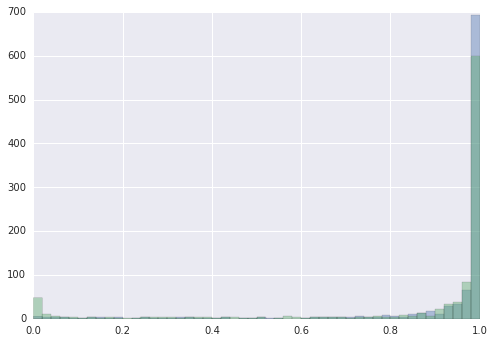

In [69]:
sns.distplot(orig_Y_pred_correct, kde=False)
sns.distplot(poisoned_Y_pred_correct, kde=False)


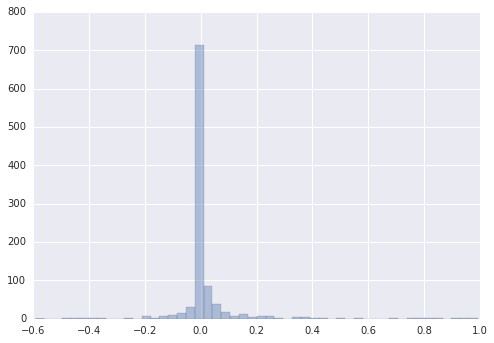

In [68]:
sns.distplot(orig_Y_pred_correct - Y_pred_correct, kde=False)

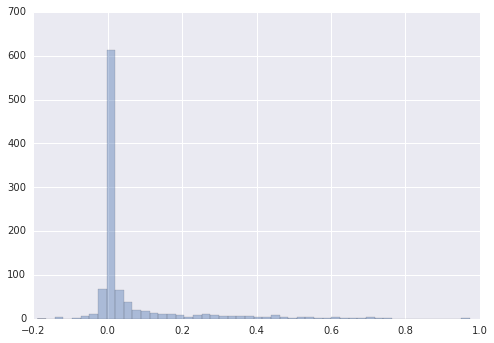

In [64]:
sns.distplot(orig_Y_pred_correct - poisoned_Y_pred_correct, kde=False)

True: 0.0
Predicted: [  1.48447621e-09   3.59972619e-05   1.84162855e-04   9.94826734e-01
   2.60378001e-03   1.22097656e-04   3.62382380e-05   1.70509284e-05
   1.00722882e-05   2.16390658e-03]


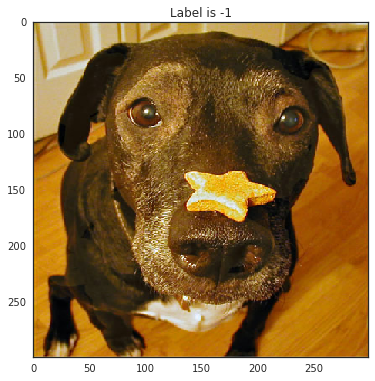

In [65]:
print('True: %s' % Y_test[test_idx])
print('Predicted: %s' % Y_pred[test_idx])

test_image = reverse_preprocess(np.copy(image_data_sets.test.x[test_idx, :]))
test_label = image_data_sets.test.labels[test_idx]
plot_flat_colorimage(test_image, test_label, side=299)

# Pictures of animals and their predictions (without poisoning)

True: 0.0
Predicted: [  9.93492901e-01   7.68667014e-05   5.92689728e-04   3.35619436e-03
   7.16991839e-04   3.13720084e-04   2.36264925e-04   8.47417905e-05
   2.30153655e-05   1.10662507e-03]


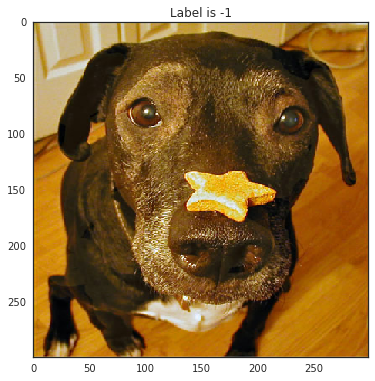

In [61]:
test_idx = 1
print('True: %s' % Y_test[test_idx])
print('Predicted: %s' % Y_pred[test_idx, :])

test_image = reverse_preprocess(np.copy(image_data_sets.test.x[test_idx, :]))
test_label = image_data_sets.test.labels[test_idx]
plot_flat_colorimage(test_image, test_label, side=299)

True: 1.0
Predicted: 0.999451
Log loss: 0.000549049874037


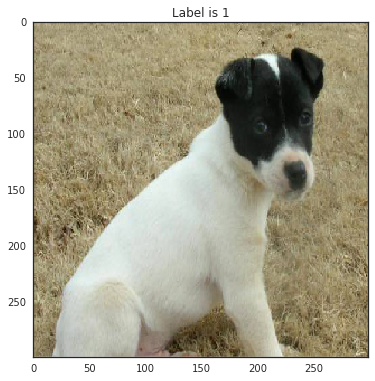

In [237]:
test_idx = 15
print('True: %s' % Y_test[test_idx])
print('Predicted: %s' % Y_pred[test_idx])
log_loss = -np.log(Y_test[test_idx] * Y_pred[test_idx] + (1 - Y_test[test_idx]) * (1 - Y_pred[test_idx]))
print('Log loss: %s' % log_loss)

test_image = reverse_preprocess(np.copy(image_data_sets.test.x[test_idx, :]))
test_label = image_data_sets.test.labels[test_idx]
plot_flat_colorimage(test_image, test_label, side=299)

True: 1.0
Predicted: 0.888253
Log loss: 0.118498696429


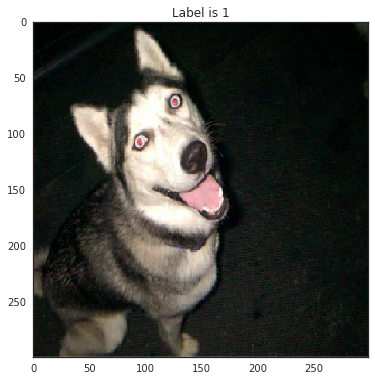

In [241]:
test_idx = 33
print('True: %s' % Y_test[test_idx])
print('Predicted: %s' % Y_pred[test_idx])
log_loss = -np.log(Y_test[test_idx] * Y_pred[test_idx] + (1 - Y_test[test_idx]) * (1 - Y_pred[test_idx]))
print('Log loss: %s' % log_loss)

test_image = reverse_preprocess(np.copy(image_data_sets.test.x[test_idx, :]))
test_label = image_data_sets.test.labels[test_idx]
plot_flat_colorimage(test_image, test_label, side=299)

825
True: 0.0
Predicted: 0.0414969
Log loss: 0.0423824617834


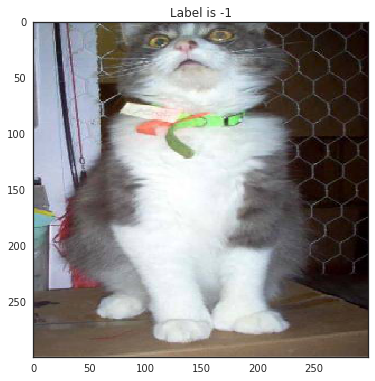

In [242]:
sort_idx = 484
np.sort(Y_pred)[sort_idx]
test_idx = np.argsort(Y_pred)[sort_idx]
print(test_idx)
print('True: %s' % Y_test[test_idx])
print('Predicted: %s' % Y_pred[test_idx])
log_loss = -np.log(Y_test[test_idx] * Y_pred[test_idx] + (1 - Y_test[test_idx]) * (1 - Y_pred[test_idx]))
print('Log loss: %s' % log_loss)

test_image = reverse_preprocess(np.copy(image_data_sets.test.x[test_idx, :]))
test_label = image_data_sets.test.labels[test_idx]
plot_flat_colorimage(test_image, test_label, side=299)

True: 0.0
Predicted: 0.000371538


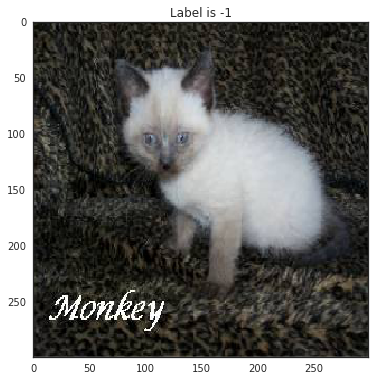

In [73]:
test_idx = 45
print('True: %s' % Y_test[test_idx])
print('Predicted: %s' % Y_pred[test_idx])

test_image = reverse_preprocess(np.copy(image_data_sets.test.x[test_idx, :]))
test_label = image_data_sets.test.labels[test_idx]
plot_flat_colorimage(test_image, test_label, side=299)

# How different are the poisoned examples vs. normal variation?

In [78]:
np.min(image_data_sets.train.x)

-1.0

In [79]:
centers

array([[-0.15708911, -0.14228433,  0.01859124, ...,  0.14652792,
        -0.08452277,  0.00155818],
       [-0.10103229, -0.01307835, -0.14758964, ..., -0.05739734,
        -0.01313132,  0.04331716]])

In [80]:
label_indices

array([False, False, False, False,  True,  True,  True,  True,  True,
        True, False, False,  True,  True,  True,  True, False,  True,
       False, False, False, False,  True, False, False, False, False,
        True,  True, False, False, False,  True, False,  True, False,
       False,  True, False,  True, False, False,  True, False,  True,
       False, False, False,  True, False,  True,  True, False,  True,
        True,  True,  True,  True, False,  True,  True,  True, False,
       False,  True,  True, False, False,  True,  True, False, False,
        True,  True,  True,  True, False, False, False,  True, False,
        True,  True, False,  True,  True,  True, False,  True,  True,
        True, False, False,  True, False, False, False, False, False, False], dtype=bool)

In [81]:
distances.shape

(1000, 268203)

In [16]:
# Compute average l2 distance of each training example to their 
# cluster center
dim = image_data_sets.train.x.shape[1]
centers = np.zeros([2, dim])
avg_dist = np.zeros([2])
for label in [0, 1]:
    label_indices = (image_data_sets.train.labels == label)
    centers[label, :] = np.mean(image_data_sets.train.x[label_indices, :], axis=0)
    dists = image_data_sets.train.x[label_indices, :] - centers[label]
    avg_dist[label] = np.mean(np.linalg.norm(dists, axis=1))

avg_dist

array([ 263.68387306,  257.04856512])

In [17]:
# Compute l2 distance of a perturbed example to the original example
# Each pixel is modified by (2.0 / 255)
perturbed_distance = np.sqrt(dim * 2.0 / 255)
perturbed_distance

45.864506333072754

array([ 19.92613171,  22.4012713 ])

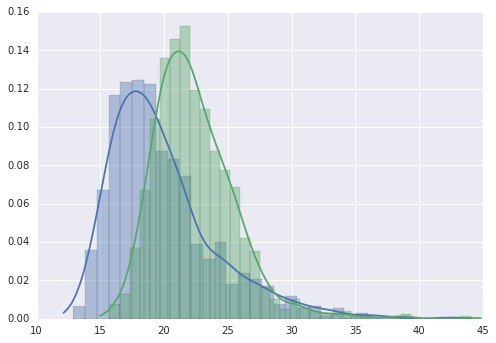

In [82]:
### Feature space
normal_train_dict = np.load('data/%s_features_train.npz' % model_string)
X = normal_train_dict['inception_features_val']
Y = normal_train_dict['labels']

dim = X.shape[1]
centers = np.zeros([2, dim])
avg_dist = np.zeros([2])
for label in [0, 1]:
    label_indices = (Y == label)
    centers[label, :] = np.mean(X[label_indices, :], axis=0)
    dists = X[label_indices, :] - centers[label]
    norms = np.linalg.norm(dists, axis=1)
    avg_dist[label] = np.mean(np.linalg.norm(dists, axis=1))
    sns.distplot(norms)

avg_dist

In [83]:
normal_train_dict = np.load('data/%s_features_train.npz' % model_string)
X = normal_train_dict['inception_features_val']
Y = normal_train_dict['labels']

poisoned_train_dict = np.load('data/normal_dog_2000_1000_inception_inception_features_poisoned_train_influence_poison-maxgrad-linf-replace-0.05_testidx_825.npz')
X_poison = poisoned_train_dict['inception_features_val']
Y_poison = poisoned_train_dict['labels']

In [84]:
assert all(Y == Y_poison)
modified_idx = np.where(~np.all(X == X_poison, axis=1))[0]
dists = X_poison[modified_idx, :] - X[modified_idx, :]
np.mean(np.linalg.norm(dists, axis=1))


23.580151

array([ 31.01453623,  29.19473356])

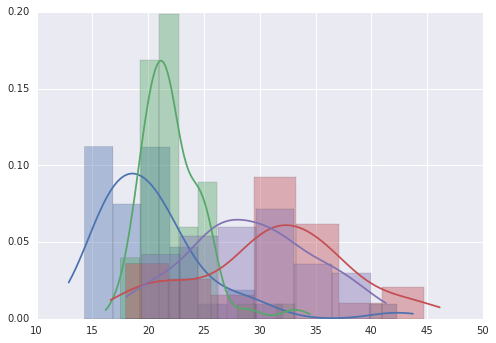

In [85]:
for label in [0, 1]:
    label_indices = (Y_poison == label)
    centers[label, :] = np.mean(X_poison[label_indices, :], axis=0)        
    dists = X_poison[label_indices, :] - centers[label]
    norms = np.linalg.norm(dists, axis=1)
    avg_dist[label] = np.mean(np.linalg.norm(dists, axis=1))

X_unmodified = X_poison[~modified_idx, :]
Y_unmodified = Y_poison[~modified_idx]
for label in [0, 1]:
    label_indices = (Y_unmodified == label)
    dists = X_unmodified[label_indices, :] - centers[label]
    avg_dist[label] = np.mean(np.linalg.norm(dists, axis=1))
    norms = np.linalg.norm(dists, axis=1)
    sns.distplot(norms)

X_modified = X_poison[modified_idx, :]
Y_modified = Y_poison[modified_idx]
for label in [0, 1]:
    label_indices = (Y_modified == label)
    dists = X_modified[label_indices, :] - centers[label]
    avg_dist[label] = np.mean(np.linalg.norm(dists, axis=1))
    norms = np.linalg.norm(dists, axis=1)
    sns.distplot(norms)
avg_dist

In [87]:
np.linalg.norm(centers[0, :] - centers[1, :])

20.578502823118829

# Visualize poisoned training examples

In [13]:
f = np.load('data/skewed_dog_inception_poisoned_data_sets_testidx_403.npy')

In [19]:
poisoned_train = f[0]
validation = f[1]
test = f[2]
poisoned_data_sets = poisoned_data_sets = base.Datasets(train=poisoned_train, validation=validation, test=test)

assert np.all(poisoned_data_sets.test.x == image_data_sets.test.x)
assert all(poisoned_data_sets.test.labels == image_data_sets.test.labels)
assert all(poisoned_data_sets.train.labels == image_data_sets.train.labels)
assert (np.max(np.abs(poisoned_data_sets.train.x - image_data_sets.train.x)) * 255 / 2) <= 1.0001


In [18]:
np.min(poisoned_data_sets.train.x)

-1.0

In [16]:

# Make sure that the poisoned data sets are at most 1 different from the orig data sets in each pixel
np.max(np.abs(poisoned_data_sets.train.x - image_data_sets.train.x)) * 255 / 2

2.0000074803829193

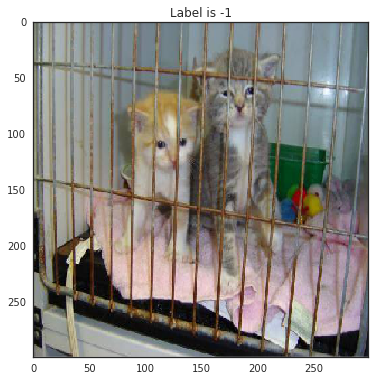

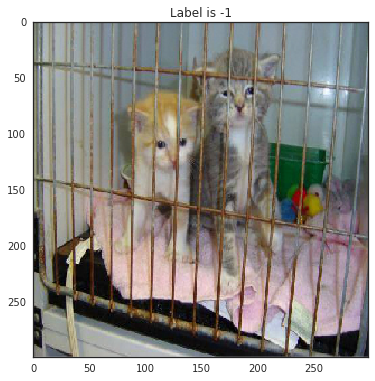

In [24]:
train_idx = 1225

orig_train_image = reverse_preprocess(np.copy(image_data_sets.train.x[train_idx, :]))
orig_train_label = image_data_sets.train.labels[train_idx]
plot_flat_colorimage(orig_train_image, orig_train_label, side=299)

poisoned_train_image = reverse_preprocess(np.copy(poisoned_data_sets.train.x[train_idx, :]))
poisoned_train_label = poisoned_data_sets.train.labels[train_idx]
plot_flat_colorimage(poisoned_train_image, poisoned_train_label, side=299)

In [34]:
diff = poisoned_train_image - orig_train_image

diff < 0

array([ True,  True,  True, ..., False,  True,  True], dtype=bool)

In [36]:
diff

array([ 0.00392157,  0.00392157,  0.00392157, ...,  0.        ,
        0.00392157,  0.00392157], dtype=float32)

In [39]:
poisoned_train_image.shape

(268203,)

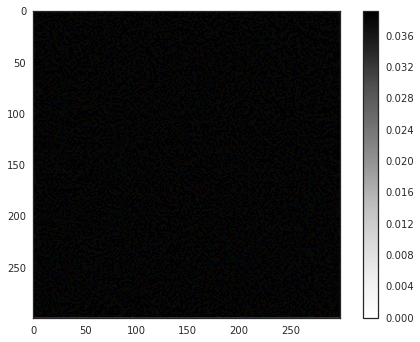

In [54]:
diff = poisoned_train_image - orig_train_image
diff[diff < 0] = 0
reshaped_diff = np.reshape(diff, [299, 299, 3])
# print(reshaped_diff[:10, :10, :])
plot_flat_colorgrad(diff * 10, side=299)

## The change in model behavior could be because of a change in the logistic regression weights, or a change in the Inception features generated.

Seems like both change...?

## How different are the learned weights?

In [88]:
# Train normal model
train_dict = np.load('data/skewed_dog_inception_morereg_inception_features_train.npz')
train = DataSet(np.reshape(train_dict['inception_features_val'], [-1, 2048]), train_dict['labels'])
test_dict = np.load('data/skewed_dog_inception_morereg_inception_features_test.npz')
test = DataSet(np.reshape(test_dict['inception_features_val'], [-1, 2048]), test_dict['labels'])
validation = None
data_sets = base.Datasets(train=train, validation=validation, test=test)
assert(all(image_data_sets.train.labels == data_sets.train.labels))
assert(all(image_data_sets.test.labels == data_sets.test.labels))

tf.reset_default_graph()

model = BinaryLogisticRegressionWithLBFGS(
    input_dim=input_dim,
    weight_decay=weight_decay,
    max_lbfgs_iter=max_lbfgs_iter,
    num_classes=num_classes, 
    batch_size=batch_size,
    data_sets=data_sets,
    initial_learning_rate=initial_learning_rate,
    keep_probs=keep_probs,
    decay_epochs=decay_epochs,
    mini_batch=False,
    train_dir='data',
    log_dir='log',
    model_name='skewed_dog_inception_onlytop_poisoned')

model.train()
normal_weights = model.sess.run(model.params)[0]

# Train poisoned model
test_idx = 403

train_dict = np.load('data/skewed_dog_inception_inception_features_poisoned_train_influence_testidx_%s.npz' % test_idx) 
train = DataSet(np.reshape(train_dict['inception_features_val'], [-1, 2048]), train_dict['labels'])
test_dict = np.load('data/skewed_dog_inception_morereg_inception_features_test.npz')
test = DataSet(np.reshape(test_dict['inception_features_val'], [-1, 2048]), test_dict['labels'])
validation = None
data_sets = base.Datasets(train=train, validation=validation, test=test)
assert(all(image_data_sets.train.labels == data_sets.train.labels))
assert(all(image_data_sets.test.labels == data_sets.test.labels))
tf.reset_default_graph()

model = BinaryLogisticRegressionWithLBFGS(
    input_dim=input_dim,
    weight_decay=weight_decay,
    max_lbfgs_iter=max_lbfgs_iter,
    num_classes=num_classes, 
    batch_size=batch_size,
    data_sets=data_sets,
    initial_learning_rate=initial_learning_rate,
    keep_probs=keep_probs,
    decay_epochs=decay_epochs,
    mini_batch=False,
    train_dir='data',
    log_dir='log',
    model_name='skewed_dog_inception_onlytop_poisoned')

model.train()
poisoned_weights = model.sess.run(model.params)[0]

Total number of parameters: 2048
Using normal model
LBFGS training took [30] iter.
After training with LBFGS: 
Train loss on all data: 0.0123257
Train acc on all data:  1.0
Test acc on all data:   0.982857142857
Norm of the mean of gradients: 1.30656e-06
Norm of the params: 1.23108
Total number of parameters: 2048
Using normal model
LBFGS training took [34] iter.
After training with LBFGS: 
Train loss on all data: 0.014132
Train acc on all data:  1.0
Test acc on all data:   0.778571428571
Norm of the mean of gradients: 1.07193e-06
Norm of the params: 1.34328


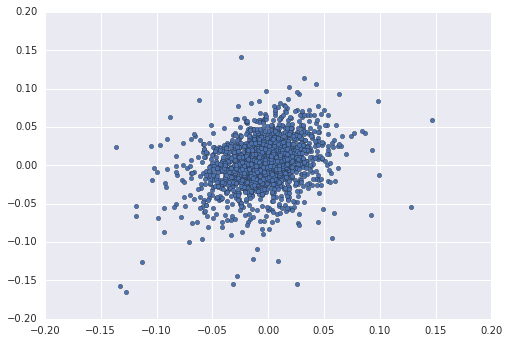

In [89]:
plt.scatter(normal_weights, poisoned_weights)

In [90]:
poisoned_weights.shape

(2048,)

## How different are the Inception features?

In [79]:
# Normal
normal_train_dict = np.load('data/skewed_dog_inception_morereg_inception_features_train.npz')

# Poisoned
test_idx = 10
poisoned_train_dict = np.load('data/skewed_dog_inception_inception_features_poisoned_train_influence_testidx_%s.npz' % test_idx) 
# poisoned_train_dict = np.load('data/skewed_dog_inception_inception_features_poisoned_train_random_testidx_None.npz')
# poisoned_train_dict = np.load('data/skewed_dog_inception_inception_features_poisoned_train_traingrad_testidx_None.npz')
# poisoned_train_dict = np.load('data/skewed_dog_inception_inception_features_poisoned_train_mirror_testidx_%s.npz' % test_idx)

# poisoned_train_dict = np.load('data/skewed_dog_inception_inception_features_poisoned_train_testidx_None.npz')

X_train_normal = normal_train_dict['inception_features_val']
X_train_poisoned = poisoned_train_dict['inception_features_val']

Y_train_normal = normal_train_dict['labels']
Y_train_poisoned = poisoned_train_dict['labels']
assert(all(Y_train_normal == Y_train_poisoned))
# np.reshape(train_dict['inception_features_val'], [-1, 2048]

In [80]:
diff = X_train_normal - X_train_poisoned
diff_norm = np.linalg.norm(diff, axis=1)
normal_norm = np.linalg.norm(X_train_normal, axis=1)
poisoned_norm = np.linalg.norm(X_train_poisoned, axis=1)

(15, 55)

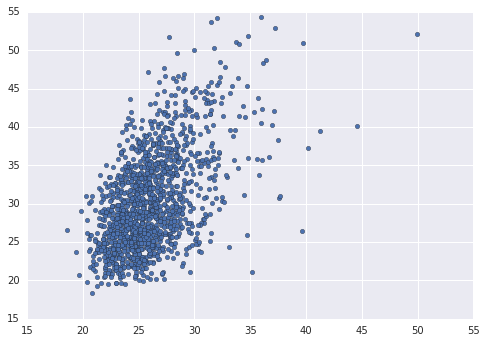

In [87]:
plt.scatter(normal_norm, poisoned_norm)
plt.xlim(15, 55)
plt.ylim(15, 55)

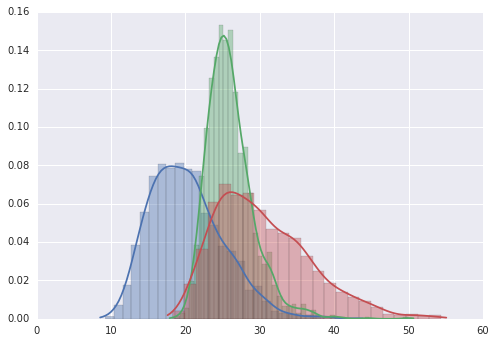

In [82]:
sns.distplot(diff_norm)
sns.distplot(normal_norm)
sns.distplot(poisoned_norm)

# Blue: Differences
# Green: Original
# Red: Poisoned